# Initialization
---
- example data (Ribalet et al. 2019, 3 days Prochlorococcus)

In [1]:
library(tidyverse)
library(DEoptim)
library(cmaes) 
library(ssPopModel)
library(plotly)

df <- read_csv("PRO_data/SeaFlow_SizeDist.csv") # load 4 days of observed Prochlorococcus size distribution (from Ribalet et al. 2019)

# Change temporal resolution from  3 minutes to 1 hour
dfh <- df %>%
        group_by(time = cut(time, breaks="1 hour")) %>%
        summarise_all(list(mean))
# time was converted to factor, and need to be convereted back to POSIXt
dfh$time <- as.POSIXct(dfh$time, tz='GMT')

# transform size class intervals to mean values (i.e. convert breaks (min, max] to mean). 
breaks <- strsplit(sub("\\]","",sub("\\(","",colnames(dfh)[-c(1,2)])),",")
midval <- unlist(list(lapply(breaks, function(x) mean(as.numeric(x)))))
colnames(dfh)[-c(1,2)] <- midval

-- Attaching packages --------------------------------------- tidyverse 1.2.1 --
v ggplot2 3.2.0     v purrr   0.3.2
v tibble  2.1.3     v dplyr   0.8.3
v tidyr   0.8.3     v stringr 1.4.0
v readr   1.3.1     v forcats 0.4.0
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()
Loading required package: parallel

DEoptim package
Differential Evolution algorithm in R
Authors: D. Ardia, K. Mullen, B. Peterson and J. Ulrich

Loading required package: popcycle

Attaching package: 'plotly'

The following object is masked from 'package:ggplot2':

    last_plot

The following object is masked from 'package:stats':

    filter

The following object is masked from 'package:graphics':

    layout

Parsed with column specification:
cols(
  .default = col_double(),
  time = col_datetime(format = "")
)
See spec(...) for full column specifications.
Warning message:
"Factor `time` contains implicit

In [2]:
### plot 4 days size distribution
z <- as.matrix(dfh[,-c(1,2)])
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

In [2]:
### select 1 day Size distribution
id <- 17:41                             
distribution <- dfh[id,-c(2)]

### smooth the size distribution
dist <- t(apply(distribution[,-c(1)],1, function(x) smooth.spline(x, all.knots=TRUE)$y))
dist[which(dist < 0)] <- 0                              
distribution[,-c(1)] <- dist
              
z <- as.matrix(distribution[,-c(1)])
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))


HTML widgets cannot be represented in plain text (need html)

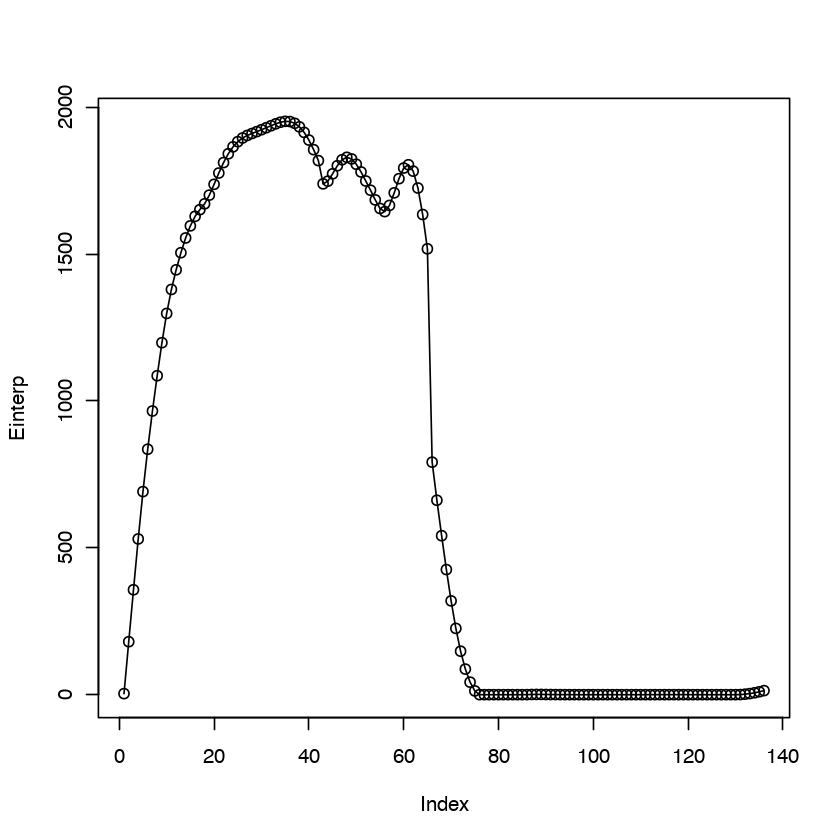

In [3]:
### smooth PAR data

# select PAR data covering the range of the size distribution
dfp <- subset(df, time  >= min(distribution$time) & time  < max(distribution$time))

# Change temporal resolution from  3 minutes to 10 minutes
Edata <- dfp[,c("time","par")] %>%
        group_by(time = cut(time, breaks="10 min")) %>%
        summarise_all(list(mean))

# smooth spline
ep <- smooth.spline(Edata, all.knots=TRUE)
Einterp <- ep$y
Einterp[Einterp < 0] <- 0

#plot
plot(Einterp, type='o')

In [4]:
### set parameters for model
breaks <- strsplit(sub("\\]","",sub("\\(","",colnames(distribution)[-1])),",")
volbins <-  as.numeric(unlist(list(lapply(breaks, function(x) mean(as.numeric(x))))))                                   
resol <- 10
dt <- resol/60

- Load matrix model

In [5]:
#######################
## matrix.conct.fast ##
#######################
#Construct matrix A(t) for each time step within an hour based on delta and gamma at each 10 minute time intervals then construct B(t) which is A(t)'s multiplied for the given hour
#multiply B(t)*w(t) to get the projection to next hour dist if desired

.matrix.conct.fast <- function(hr, Einterp, volbins, gmax, dmax, b, E_star, resol){

		########################
		## INITIAL PARAMETERS ##
		########################
		t.nodiv <- 0 # no division during the first X hours after dawn
		dt <- resol/60
		j <- findInterval(2 * volbins[1], volbins)
		m <- length(volbins) # dimensions of the squared matrix

		####################
		## GAMMA FUNCTION ## fraction of cells that grow into next size class between t and t + dt
		####################
		# y <- (1-exp(-Einterp/E_star)) * gmax # original 2003 model
		y <- (gmax/E_star) * Einterp # NEW VERSION
		y[which(Einterp >= E_star)] <- gmax

		##########################
		## Respiration FUNCTION ## fraction of cells that shrink between t and t + dt
		##########################
				# Assumptions:
				# 1) rate of respiration is a function of photosynthetic rate (gamma function)
				# 2) rate of respiration constant (h-1) constant over the nighttime period (polysaccharide is drawn down linearly over the nighttime period)
        resp <-  rep(0, length(y)) # proportion of carbon storage to total carbon

		####################
		## DELTA FUNCTION ## fraction of cells that divide between t and t + dt
		####################
		a <- 1	# NOTE: most values of volbins need to be < 1 for compatibility issue with the Delta function # based on HYNES et al. 2015
		del <- dmax * (a*volbins/max(volbins))^b / (1 + (a*volbins/max(volbins))^b)

		# del[1:(j-1)] <- 0
				if(hr <= t.nodiv){delta <- matrix(data=0, 1, m)
					}else{delta <- matrix(del, 1, m)}
        

		#########################
		## ALLOMETRIC FUNCTION ## 
		#########################
		allo <- rep(1,length(volbins)) # no allometric relationship

  
        ################################
		## CONSTRUCTION SPARSE MATRIX ##
		################################
    	stasis_ind <- seq(1,m^2,by=m+1) # Diagonal (0)stasis 
		growth_ind <- seq(2,m^2,by=m+1) # Subdiagonal (-1) growth 
		resp_ind <- seq(m+1, m^2, by=m+1) # Superdiagonal (+1) respiration 
		div_ind <- seq((((j-1)*m)+1), m^2, by=m+1) # Superdiagonal (j-1) division

		for(t in 1:(1/dt)){
			#t <- 1
			A <- matrix(data=0,nrow=m, ncol=m)
			gamma <- y[t+hr/dt]*allo
			respiration <- resp[t+hr/dt]*allo
			# plot(volbins, gamma); abline(h=c(y[t+hr/dt] , mean(gamma)), col=c(1,2));points(volbins, respiration,col=3)

			# Stasis (main diagonal)
			A[stasis_ind] <- (1-delta)*(1-gamma)*(1-respiration) # the hr/dt part in the indexing is because each hour is broken up into dt segments for the irradiance spline
			A[m,m] <- (1-delta[m])*(1-respiration[m])

			# Cell growth (subdiagonal)
			A[growth_ind] <- gamma[1:(m-1)]*(1-delta[1:(m-1)])*(1-respiration[1:(m-1)])

			# Division (first row and superdiagonal j-1)
			A[1,1:(j-1)] <- A[1,1:(j-1)] + 2 * delta[1:(j-1)] # Top row; Small phytoplanktoin (i=1,..., j-1) are less than twice as big as the smallest size class, and so newly divided are put in the smallest size class.
			A[div_ind] <- 2 * delta[j:m] # The cell division terms for large (i > = j) phytoplankton

			# Respiration (superdiagonal)
			A[1,2] <- A[1,2]  + respiration[1]
			A[resp_ind] <- respiration[-1]*(1-delta[-1])*(1-respiration[-1])

					if(t == 1){B <- A}else{B <- A %*% B}
			}

		return(B)
}

# 1. Objective functions
---

- ### sum of squared residuals 
$$
Resid = \sum_{i=1}^{24} \sum_{i=1}^{n} (y - \hat{y})^2

In [6]:
###############
## sigma.lsq ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# This function returns a column vector - called by "determine.opt.para" for the optimization.

	.sigma.lsq <- function(params, Einterp, distribution, resol){

				time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, dim[1], dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1]) 
                dmax <- as.numeric(params[2]) 
                b <- as.numeric(params[3]) 
                E_star <- as.numeric(params[4]) 

			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% PDF[,hr]/max(PDF[,hr]) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
					sigma[,hr] <-  (PDF[,hr+1] - round(TotN[hr+1]*wt.norm))^2 # ABSOLUTE observed value - fitted value
					}
			sigma <- colSums(sigma)/colSums(PDF[,-1])
			sigma <- mean(sigma, na.rm=T)
			return(sigma)

}

In [7]:
############### 
## sigma.lsq ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# This function returns a column vector - called by "determine.opt.para" for the optimization.

	.sigma.lsq.norm <- function(params, Einterp, distribution, resol){

				time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, dim[1], dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1]) 
                dmax <- as.numeric(params[2])
                b <- as.numeric(params[3]) * 10
                E_star <- as.numeric(params[4]) * 1000

			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% PDF[,hr]/max(PDF[,hr]) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
					sigma[,hr] <-  (PDF[,hr+1] - round(TotN[hr+1]*wt.norm))^2 # ABSOLUTE observed value - fitted value
					}
			sigma <- colSums(sigma)/colSums(PDF[,-1])
			sigma <- mean(sigma, na.rm=T)
			return(sigma)

}

In [8]:
start_time <- Sys.time()

f <- function(params) .sigma.lsq(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt <- DEoptim(f, lower=c(1e-6,1e-6,1e-6,1), upper=c(1,1,15,max(Einterp)), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))

Sys.time() - start_time

params <- opt$optim$bestmem
        gmax <- as.numeric(params[1]) 
        dmax <- as.numeric(params[2])
        b <- as.numeric(params[3]) 
        E_star <- as.numeric(params[4]) 
		resnorm <- opt$optim$bestval


Iteration: 10 bestvalit: 36.745002 bestmemit:    0.159873    0.397095    4.364920  860.215186
Iteration: 20 bestvalit: 35.974739 bestmemit:    0.148803    0.189121    3.707526  335.727136
Iteration: 30 bestvalit: 35.927963 bestmemit:    0.157406    0.180030    3.573739  285.303630
Iteration: 40 bestvalit: 35.912078 bestmemit:    0.157057    0.169657    3.485860  419.933493
Iteration: 50 bestvalit: 35.911936 bestmemit:    0.156591    0.169657    3.485860  425.858424
Iteration: 60 bestvalit: 35.908632 bestmemit:    0.155724    0.183024    3.569609  312.194121
Iteration: 70 bestvalit: 35.904401 bestmemit:    0.154171    0.185732    3.571961  321.589007
Iteration: 80 bestvalit: 35.904393 bestmemit:    0.154171    0.185732    3.571961  315.233383
Iteration: 90 bestvalit: 35.904393 bestmemit:    0.154171    0.185732    3.571961  315.233383
Iteration: 100 bestvalit: 35.904055 bestmemit:    0.154171    0.185732    3.571961  316.985451
Iteration: 110 bestvalit: 35.903862 bestmemit:    0.155483 

Time difference of 3.481066 mins

In [9]:
start_time <- Sys.time()

f <- function(params) .sigma.lsq.norm(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt. <- DEoptim(f, lower=c(1e-6,1e-6,1e-6,1e-6), upper=c(1,1,1,1), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))

Sys.time() - start_time

params <- opt.$optim$bestmem
        gmax <- as.numeric(params[1]) 
        dmax <- as.numeric(params[2]) 
        b <- as.numeric(params[3]) * 10
        E_star <- as.numeric(params[4]) * 1000
		resnorm <- opt.$optim$bestval


Iteration: 10 bestvalit: 36.213556 bestmemit:    0.175029    0.219764    0.373828    0.285763
Iteration: 20 bestvalit: 35.954752 bestmemit:    0.163564    0.170695    0.343976    0.449361
Iteration: 30 bestvalit: 35.920820 bestmemit:    0.154621    0.175578    0.356005    0.303202
Iteration: 40 bestvalit: 35.908445 bestmemit:    0.156301    0.184722    0.356588    0.321484
Iteration: 50 bestvalit: 35.908445 bestmemit:    0.156301    0.184722    0.356588    0.321484
Iteration: 60 bestvalit: 35.906257 bestmemit:    0.154581    0.187191    0.357176    0.313991
Iteration: 70 bestvalit: 35.905685 bestmemit:    0.155109    0.180631    0.355199    0.319023
Iteration: 80 bestvalit: 35.903882 bestmemit:    0.154811    0.184539    0.356003    0.318661
Iteration: 90 bestvalit: 35.903882 bestmemit:    0.154811    0.184539    0.356003    0.318661
Iteration: 100 bestvalit: 35.903882 bestmemit:    0.154811    0.184539    0.356003    0.318661
Iteration: 110 bestvalit: 35.903882 bestmemit:    0.154811 

Time difference of 3.298831 mins

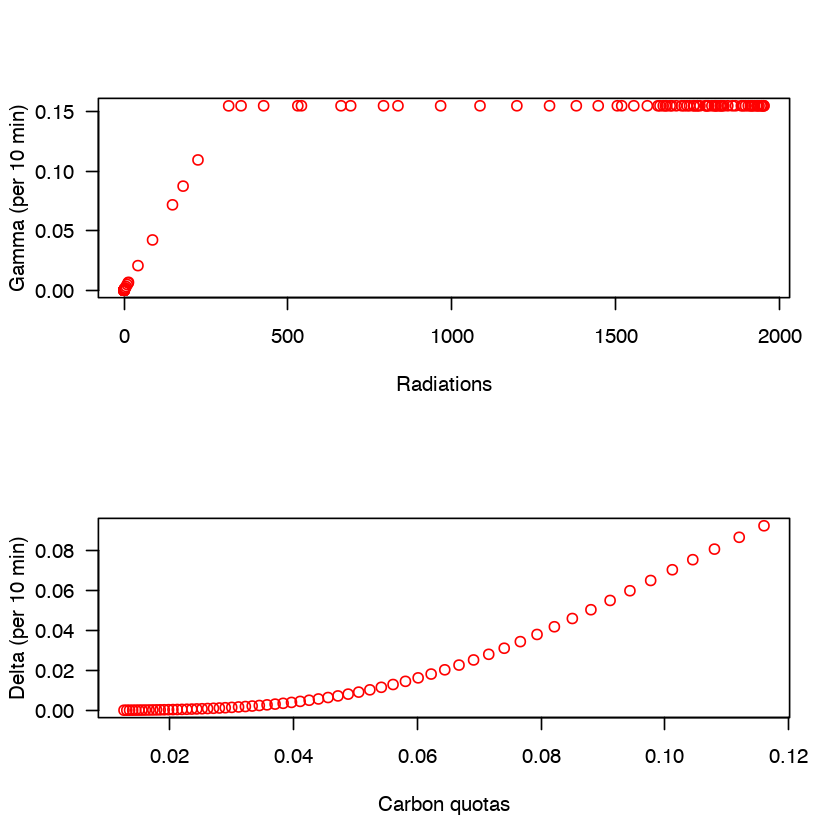

In [10]:
## PLOT GAMMA AND DELTA
y <- (gmax/E_star) * Einterp 
y[which(Einterp >= E_star)] <- gmax

a <- 1	# NOTE: most values of volbins need to be < 1 for compatibility issue with the Delta function # based on HYNES et al. 2015
del <- dmax * (a*volbins/max(volbins))^b / (1 + (a*volbins/max(volbins))^b)
delta <- matrix(del, 1, length(volbins))       

par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, del, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)

- ### Huber loss 
$$
L =\begin{cases}
\frac12(y - \hat{y})^2 & for |y - \hat{y}| \leq d\\
d|y - \hat{y}| - \frac12 d^2 & otherwise
\end{cases}
$$


In [11]:
###############
## sigma.hl ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# using Hubert Loss (1954) approach.

	.sigma.hl <- function(params, Einterp, distribution, resol){

				time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, 1, dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1])
                dmax <- as.numeric(params[2]) 
                b <- as.numeric(params[3]) 
                E_star <- as.numeric(params[4])

        delta <- 10 * 1.345
			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% PDF[,hr]/max(PDF[,hr]) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
                    # Huber loss calculation
                    a <- PDF[,hr+1] - round(TotN[hr+1]*wt.norm)
                    loss <- ifelse(abs(a) <= delta,
                                       0.5 * a^2,
                                       delta * (abs(a) - 0.5 * delta))
                    sigma[,hr] <- mean(loss)
                    }
            sigma <- sum(sigma, na.rm=T)/100 ## HUBER loss

			return(sigma)
        
}

In [12]:
###############
## sigma.hl ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# using Hubert Loss (1954) approach.

	.sigma.hl.norm <- function(params, Einterp, distribution, resol){

				time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, 1, dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1]) 
                dmax <- as.numeric(params[2]) 
                b <- as.numeric(params[3]) * 10
                E_star <- as.numeric(params[4]) * 1000

        delta <- 10*1.345
			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% PDF[,hr]/max(PDF[,hr]) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
                    # Huber loss calculation
                    a <- PDF[,hr+1] - round(TotN[hr+1]*wt.norm)
                    loss <- ifelse(abs(a) <= delta,
                                       0.5 * a^2,
                                       delta * (abs(a) - 0.5 * delta))
                    sigma[,hr] <- mean(loss)
                    }
            sigma <- sum(sigma, na.rm=T)/100 ## HUBER loss

			return(sigma)

}

In [13]:
start_time <- Sys.time()

f <- function(params) .sigma.hl(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt.. <- DEoptim(f, lower=c(1e-6,1e-6,1e-6,1), upper=c(1,1,15,max(Einterp)), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))

Sys.time() - start_time

		params <- opt..$optim$bestmem
        gmax. <- as.numeric(params[1]) 
        dmax. <- as.numeric(params[2]) 
        b. <- as.numeric(params[3]) 
        E_star. <- as.numeric(params[4])
		resnorm. <- opt..$optim$bestval

Iteration: 10 bestvalit: 561.292239 bestmemit:    0.129341    0.247049    6.404954  266.251857
Iteration: 20 bestvalit: 559.368669 bestmemit:    0.130452    0.037220    3.536390  244.864800
Iteration: 30 bestvalit: 558.885601 bestmemit:    0.131054    0.111541    4.286291  195.706201
Iteration: 40 bestvalit: 558.664271 bestmemit:    0.130248    0.112711    4.096436  192.775722
Iteration: 50 bestvalit: 558.608284 bestmemit:    0.131896    0.098258    3.869285  181.574054
Iteration: 60 bestvalit: 558.580920 bestmemit:    0.132843    0.095876    3.900911  212.676897
Iteration: 70 bestvalit: 558.544217 bestmemit:    0.131606    0.100576    3.906341  190.233553
Iteration: 80 bestvalit: 558.541813 bestmemit:    0.131606    0.100576    3.906341  188.471686
Iteration: 90 bestvalit: 558.541813 bestmemit:    0.131606    0.100576    3.906341  188.471686
Iteration: 100 bestvalit: 558.541813 bestmemit:    0.131606    0.100576    3.906341  188.471686
Iteration: 110 bestvalit: 558.541813 bestmemit:  

Time difference of 3.380246 mins

In [14]:
start_time <- Sys.time()

f <- function(params) .sigma.hl.norm(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt... <- DEoptim(f, lower=c(1e-6,1e-6,1e-6,1e-6), upper=c(1,1,1,1), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))

Sys.time() - start_time

		params <- opt...$optim$bestmem
        gmax. <- as.numeric(params[1]) 
        dmax. <- as.numeric(params[2]) 
        b. <- as.numeric(params[3]) * 10
        E_star. <- as.numeric(params[4]) * 1000
		resnorm <- opt...$optim$bestval


Iteration: 10 bestvalit: 561.594071 bestmemit:    0.124260    0.480089    0.842925    0.279773
Iteration: 20 bestvalit: 559.144329 bestmemit:    0.135066    0.147212    0.408807    0.135295
Iteration: 30 bestvalit: 559.026075 bestmemit:    0.135066    0.147212    0.408807    0.184304
Iteration: 40 bestvalit: 558.685922 bestmemit:    0.128415    0.068364    0.369099    0.223006
Iteration: 50 bestvalit: 558.596108 bestmemit:    0.131123    0.104021    0.397632    0.199406
Iteration: 60 bestvalit: 558.582015 bestmemit:    0.129922    0.087622    0.380667    0.198057
Iteration: 70 bestvalit: 558.577665 bestmemit:    0.131848    0.083692    0.380092    0.205758
Iteration: 80 bestvalit: 558.551280 bestmemit:    0.130359    0.092315    0.389138    0.198969
Iteration: 90 bestvalit: 558.551280 bestmemit:    0.130359    0.092315    0.389138    0.198969
Iteration: 100 bestvalit: 558.551280 bestmemit:    0.130359    0.092315    0.389138    0.198969
Iteration: 110 bestvalit: 558.551280 bestmemit:  

Time difference of 2.943988 mins

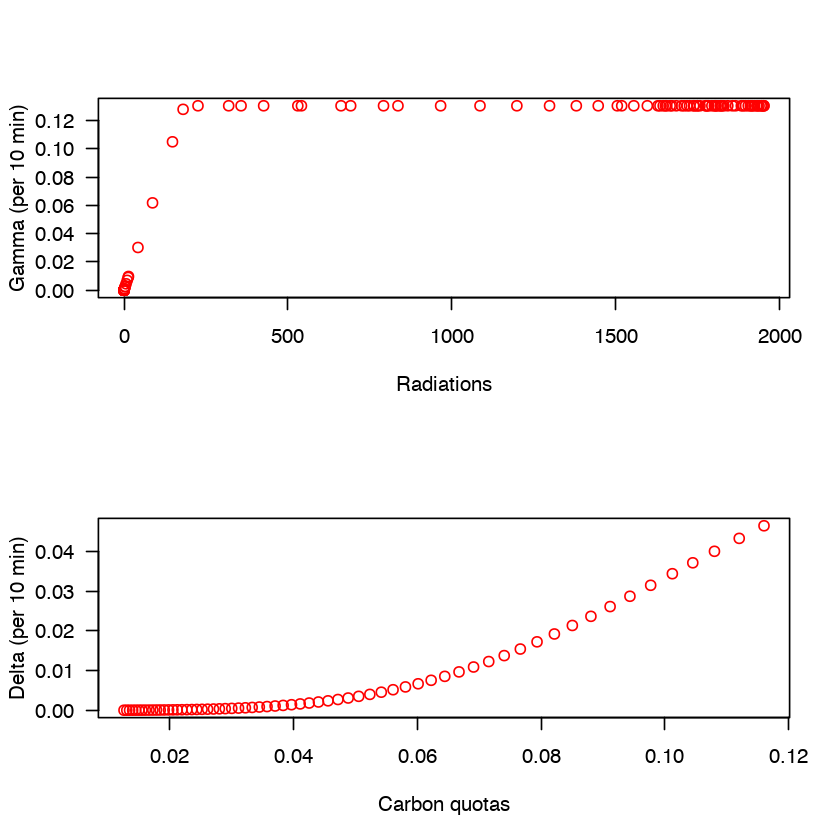

In [15]:
## PLOT GAMMA AND DELTA
y <- (gmax./E_star.) * Einterp 
y[which(Einterp >= E_star.)] <- gmax.

a <- 1	# NOTE: most values of volbins need to be < 1 for compatibility issue with the Delta function # based on HYNES et al. 2015
del <- dmax. * (a*volbins/max(volbins))^b. / (1 + (a*volbins/max(volbins))^b.)
delta <- matrix(del, 1, length(volbins))       

par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, del, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)

# 2. Results

In [16]:
####################################################
## Calculate projections from best fit parameters ##
####################################################
library(ggplot2)
library(reshape2)
time.interval <- median(diff(distribution$time))
resolution <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
Nproj <-  Nproj. <- PDF <- t(distribution[,-c(1)]) 

for(hr in resolution){
	B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
    Nproj[,hr+1] <- round(B %*% Nproj[,hr]) # calculate numbers of individuals
            		    
    B. <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax., dmax=dmax.,b=b., E_star=E_star., resol=resol)
    Nproj.[,hr+1] <- round(B. %*% Nproj.[,hr]) # calculate numbers of individuals
     		    
       }


#############################
## Growth rate calculation ##
#############################
mu_N <- round(diff(log(colSums(Nproj[,],na.rm=T)))[-c(1,24)],3)/ as.numeric(diff(distribution$time)[-c(1,24)])
mu_N. <- round(diff(log(colSums(Nproj.[,],na.rm=T)))[-c(1,24)],3)/ as.numeric(diff(distribution$time)[-c(1,24)])

d.mu_N <- 24*median(mu_N, na.rm=T)
d.mu_N. <- 24*median(mu_N., na.rm=T)

print(paste("daily growth rate=",round(d.mu_N,2),"-",round(d.mu_N.,2)))


Attaching package: 'reshape2'

The following object is masked from 'package:tidyr':

    smiths



[1] "daily growth rate= 0.26 - 0.12"


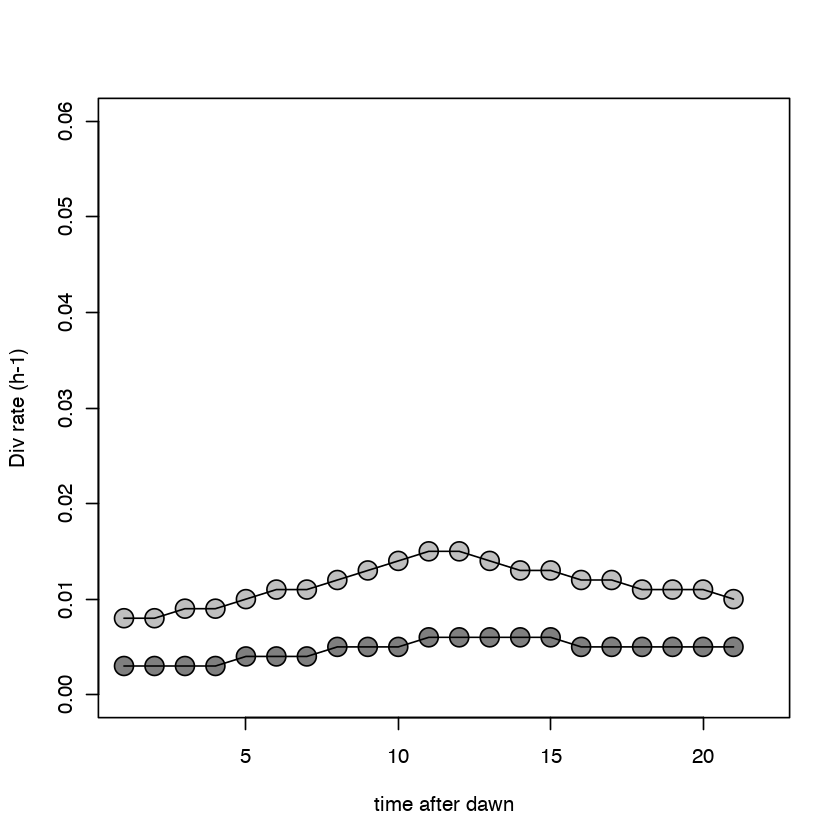

In [17]:
par(mfrow=c(1,1))
plot(mu_N,type='o', ylim=c(0,0.06), xlab='time after dawn', ylab="Div rate (h-1)", pch=21, cex=2, bg=adjustcolor(1,0.25))
    points(mu_N.,type='o', pch=21, cex=2, bg=adjustcolor(1,0.5))

In [18]:
z <- as.matrix(Nproj)
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

In [19]:
z <- as.matrix(Nproj.)
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

# 3. Optimizer

- ### Covariance matrix adapting evolutionary strategy (cmaes package)

In [20]:
start_time <- Sys.time()

f <- function(params) .sigma.lsq(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt2 <- cma_es(par=c(0.1,0.1,4,300),f, 
                  lower=c(1e-6,1e-6,1e-6,1),   
                  upper=c(1,1,15,max(Einterp)), 
                  control=list(stopfitness= 1e-3, 
                               maxit=1000)
                 )

Sys.time() - start_time

 		params <- opt2$par
        gmax2 <- as.numeric(params[1]) 
        dmax2 <- as.numeric(params[2])
        b2 <- as.numeric(params[3]) 
        E_star2 <- as.numeric(params[4]) 
		resnorm2 <- opt2$value
print(params)
print(resnorm2)

Time difference of 3.375452 mins

[1]   0.1539512   0.1923697   3.6135023 300.1849024
[1] 35.90983


In [21]:
start_time <- Sys.time()

f <- function(params) .sigma.hl(params=params, Einterp=Einterp, distribution = distribution, resol=resol)

    opt2. <- cma_es(par=c(0.1,0.1,4,300),f, 
                  lower=c(1e-6,1e-6,1e-6,1),   
                  upper=c(1,1,15,max(Einterp)), 
                  control=list(stopfitness= 1e-3, 
                               maxit=1000)
                 )

Sys.time() - start_time

 		params <- opt2.$par
        gmax2. <- as.numeric(params[1]) 
        dmax2. <- as.numeric(params[2])
        b2. <- as.numeric(params[3]) 
        E_star2. <- as.numeric(params[4]) 
		resnorm2. <- opt2.$value
print(params)
print(resnorm2.)

Time difference of 3.223127 mins

[1]   0.13345838   0.08714598   3.86988303 299.79941047
[1] 558.9256


In [22]:
start_time <- Sys.time()

f <- function(params) .sigma.lsq.norm(params=params, Einterp=Einterp, distribution = distribution, resol=resol)
    
    opt3 <- cma_es(par=c(0.1,0.2,0.4,0.3),f, 
                  lower=c(0,0,0,0),   
                  upper=c(1,1,1,1), 
                  control=list(stopfitness= 1e-3, 
                               maxit=1000)
                 )
 Sys.time() - start_time

        params <- opt3$par
        gmax3 <- as.numeric(params[1]) 
        dmax3 <- as.numeric(params[2])
        b3 <- as.numeric(params[3]) * 10
        E_star3 <- as.numeric(params[4]) * 1000
		resnorm3 <- opt3$value
print(params)
print(resnorm3)

Time difference of 5.262191 mins

[1] 0.1550242 0.1802099 0.3534632 0.3193723
[1] 35.90257


In [23]:
start_time <- Sys.time()

f <- function(params) .sigma.hl.norm(params=params, Einterp=Einterp, distribution = distribution, resol=resol)
    
    opt3. <- cma_es(par=c(0.1,0.2,0.4,0.3),f, 
                  lower=c(0,0,0,0),   
                  upper=c(1,1,1,1), 
                  control=list(stopfitness= 1e-3, 
                               maxit=1000)
                 )
 Sys.time() - start_time

        params <- opt3.$par
        gmax3. <- as.numeric(params[1]) 
        dmax3. <- as.numeric(params[2])
        b3. <- as.numeric(params[3]) * 10
        E_star3. <- as.numeric(params[4]) * 1000
		resnorm3. <- opt3.$value
print(params)
print(resnorm3.)

Time difference of 5.624703 mins

[1] 0.13161117 0.09365609 0.38745337 0.19790229
[1] 558.5466


##  Results

In [25]:
####################################################
## Calculate projections from best fit parameters ##
####################################################
library(ggplot2)
library(reshape2)
time.interval <- median(diff(distribution$time))
resolution <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
Nproj <-  Nproj. <- PDF <- t(distribution[,-c(1)]) 

for(hr in resolution){
	B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax3, dmax=dmax3, b=b3, E_star=E_star3, resol=resol)
    Nproj[,hr+1] <- round(B %*% Nproj[,hr]) # calculate numbers of individuals
            		    
    B. <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax3., dmax=dmax3., b=b3., E_star=E_star3., resol=resol)
    Nproj.[,hr+1] <- round(B. %*% Nproj.[,hr]) # calculate numbers of individuals
     		    
       }


#############################
## Growth rate calculation ##
#############################
mu_N <- round(diff(log(colSums(Nproj[,],na.rm=T)))[-c(1,24)],3)/ as.numeric(diff(distribution$time)[-c(1,24)])
mu_N. <- round(diff(log(colSums(Nproj.[,],na.rm=T)))[-c(1,24)],3)/ as.numeric(diff(distribution$time)[-c(1,24)])

d.mu_N <- 24*median(mu_N, na.rm=T)
d.mu_N. <- 24*median(mu_N., na.rm=T)

print(paste("daily growth rate=",round(d.mu_N,2),"-",round(d.mu_N.,2)))

[1] "daily growth rate= 0.26 - 0.12"


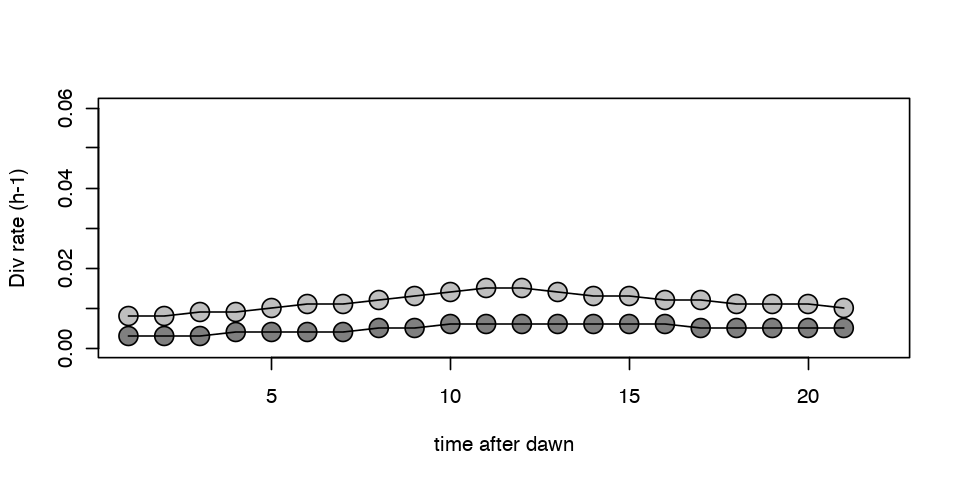

In [26]:
options(repr.plot.width=8, repr.plot.height=4)
plot(mu_N,type='o', ylim=c(0,0.06), xlab='time after dawn', ylab="Div rate (h-1)", pch=21, cex=2, bg=adjustcolor(1,0.25))
    points(mu_N.,type='o', pch=21, cex=2, bg=adjustcolor(1,0.5))

In [27]:
z <- as.matrix(Nproj)
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

In [28]:
z <- as.matrix(Nproj.)
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)